# Дипломная работа по курсу python

In [92]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

# 1. Загрузить файл HR.csv в pandas dataframe:

In [149]:
df = pd.read_csv('data/HR.csv')
df.head()

,satisfaction_level,last_evaluation,number_project,average_montly_hours,time_spend_company,Work_accident,left,promotion_last_5years,department,salary
0,0.38,0.53,2,157,3,0,1,0,sales,low
1,0.80,0.86,5,262,6,0,1,0,sales,medium
2,0.11,0.88,7,272,4,0,1,0,sales,medium
3,0.72,0.87,5,223,5,0,1,0,sales,low
4,0.37,0.52,2,159,3,0,1,0,sales,low


In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14999 entries, 0 to 14998
Data columns (total 10 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   satisfaction_level     14999 non-null  float64
 1   last_evaluation        14999 non-null  float64
 2   number_project         14999 non-null  int64  
 3   average_montly_hours   14999 non-null  int64  
 4   time_spend_company     14999 non-null  int64  
 5   Work_accident          14999 non-null  int64  
 6   left                   14999 non-null  int64  
 7   promotion_last_5years  14999 non-null  int64  
 8   department             14999 non-null  object 
 9   salary                 14999 non-null  object 
dtypes: float64(2), int64(6), object(2)
memory usage: 1.1+ MB


# 2. Основные статистики:

In [150]:
df.describe()

,satisfaction_level,last_evaluation,number_project,average_montly_hours,time_spend_company,Work_accident,left,promotion_last_5years
count,14999.000000,14999.000000,14999.000000,14999.000000,14999.000000,14999.000000,14999.000000,14999.000000
mean,0.612834,0.716102,3.803054,201.050337,3.498233,0.144610,0.238083,0.021268
std,0.248631,0.171169,1.232592,49.943099,1.460136,0.351719,0.425924,0.144281
min,0.090000,0.360000,2.000000,96.000000,2.000000,0.000000,0.000000,0.000000
25%,0.440000,0.560000,3.000000,156.000000,3.000000,0.000000,0.000000,0.000000
50%,0.640000,0.720000,4.000000,200.000000,3.000000,0.000000,0.000000,0.000000
75%,0.820000,0.870000,5.000000,245.000000,4.000000,0.000000,0.000000,0.000000
max,1.000000,1.000000,7.000000,310.000000,10.000000,1.000000,1.000000,1.000000


In [151]:
# мода
df.mode()


,satisfaction_level,last_evaluation,number_project,average_montly_hours,time_spend_company,Work_accident,left,promotion_last_5years,department,salary
0,0.1,0.55,4.0,135,3.0,0.0,0.0,0.0,sales,low
1,NaN,NaN,NaN,156,NaN,NaN,NaN,NaN,NaN,NaN


# 3. Корреляционная матрица

In [153]:
df.corr()

,satisfaction_level,last_evaluation,number_project,average_montly_hours,time_spend_company,Work_accident,left,promotion_last_5years
satisfaction_level,1.000000,0.105021,-0.142970,-0.020048,-0.100866,0.058697,-0.388375,0.025605
last_evaluation,0.105021,1.000000,0.349333,0.339742,0.131591,-0.007104,0.006567,-0.008684
number_project,-0.142970,0.349333,1.000000,0.417211,0.196786,-0.004741,0.023787,-0.006064
average_montly_hours,-0.020048,0.339742,0.417211,1.000000,0.127755,-0.010143,0.071287,-0.003544
time_spend_company,-0.100866,0.131591,0.196786,0.127755,1.000000,0.002120,0.144822,0.067433
Work_accident,0.058697,-0.007104,-0.004741,-0.010143,0.002120,1.000000,-0.154622,0.039245
left,-0.388375,0.006567,0.023787,0.071287,0.144822,-0.154622,1.000000,-0.061788
promotion_last_5years,0.025605,-0.008684,-0.006064,-0.003544,0.067433,0.039245,-0.061788,1.000000


In [154]:
quantitative_df = df[['last_evaluation', 'number_project', 'average_montly_hours', 'time_spend_company']]
quantitative_df.head()

,last_evaluation,number_project,average_montly_hours,time_spend_company
0,0.53,2,157,3
1,0.86,5,262,6
2,0.88,7,272,4
3,0.87,5,223,5
4,0.52,2,159,3


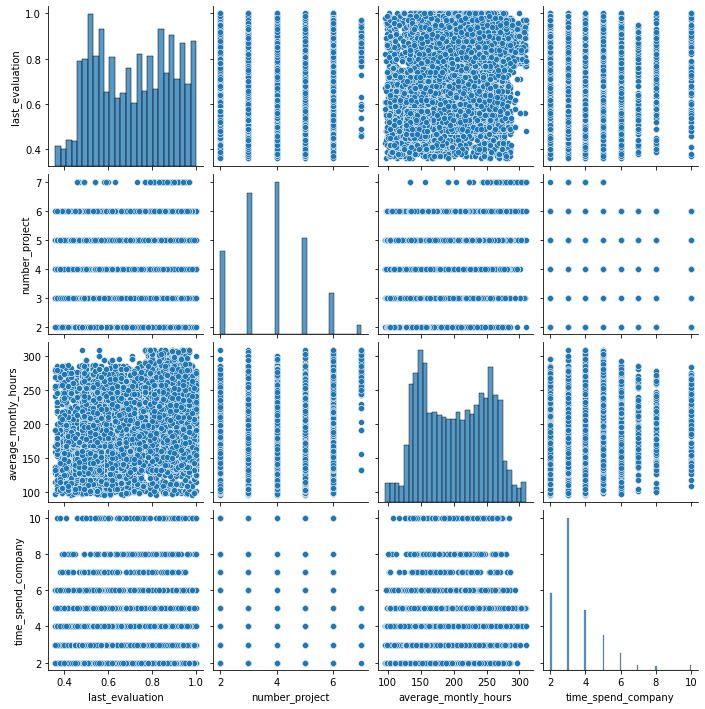

In [54]:
# Посмотрим на pair plot, как связаны между собой различные количественные признаки в наборе данных
sns.pairplot(quantitative_df)

<AxesSubplot:>

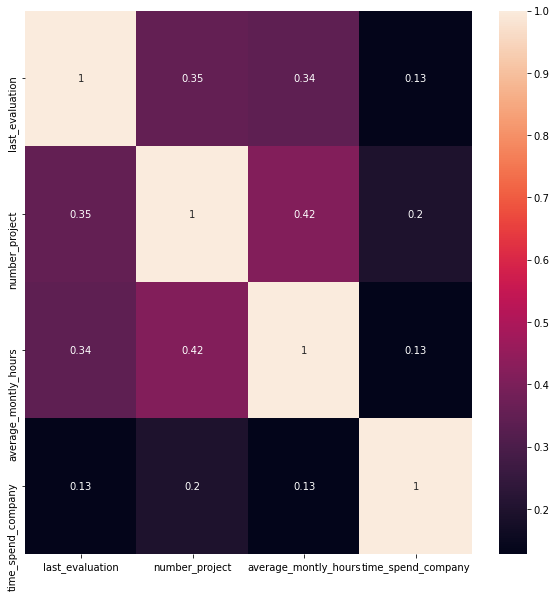

In [55]:
plt.figure(figsize=(10,10)) # увеличим немного
sns.heatmap(quantitative_df.corr(), annot=True)

In [56]:
# две самые скоррелированные переменные
# Прослеживается очевидная зависимость количества проектов от среднего кол-ва рабочих часов в месяц
quantitative_df[['number_project', 'average_montly_hours']].corr()

,number_project,average_montly_hours
number_project,1.000000,0.417211
average_montly_hours,0.417211,1.000000


<AxesSubplot:xlabel='average_montly_hours', ylabel='number_project'>

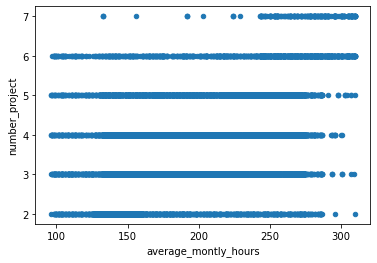

In [57]:
quantitative_df.plot(kind='scatter', x='average_montly_hours', y='number_project')
# у тех работников, которые работают более 300 часов в месяц стабильно больше проектов (>=5), бывает конечно и меньше, но реже

In [58]:
# зависимость количества проектов от времени с момента последней оценки тоже высока
quantitative_df[['number_project', 'last_evaluation']].corr()

,number_project,last_evaluation
number_project,1.000000,0.349333
last_evaluation,0.349333,1.000000


<AxesSubplot:xlabel='last_evaluation', ylabel='number_project'>

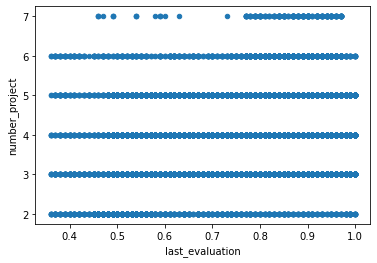

In [59]:
quantitative_df.plot(kind='scatter', x='last_evaluation', y='number_project')

In [62]:
# две наименее скоррелированные переменные
# Время с момента последней оценки со стажем
quantitative_df[['last_evaluation', 'time_spend_company']].corr()

,last_evaluation,time_spend_company
last_evaluation,1.000000,0.131591
time_spend_company,0.131591,1.000000


<AxesSubplot:xlabel='last_evaluation', ylabel='time_spend_company'>

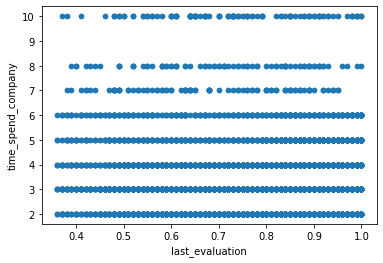

In [63]:
df.plot(kind='scatter', x='last_evaluation', y='time_spend_company')

In [64]:
# Среднее количество часов в месяц со стажем также имеют низкий коэффициент корреляции
quantitative_df[['average_montly_hours', 'time_spend_company']].corr()

,average_montly_hours,time_spend_company
average_montly_hours,1.000000,0.127755
time_spend_company,0.127755,1.000000


<AxesSubplot:xlabel='average_montly_hours', ylabel='time_spend_company'>

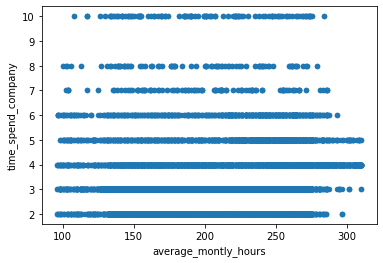

In [65]:
df.plot(kind='scatter', x='average_montly_hours', y='time_spend_company')

# 4. Сколько сотрудников в каждом департаменте.

In [68]:
df['department'].value_counts()

sales          4140
technical      2720
support        2229
IT             1227
product_mng     902
marketing       858
RandD           787
accounting      767
hr              739
management      630
Name: department, dtype: int64

# 5. Показать распределение сотрудников по зарплатам. 

<AxesSubplot:>

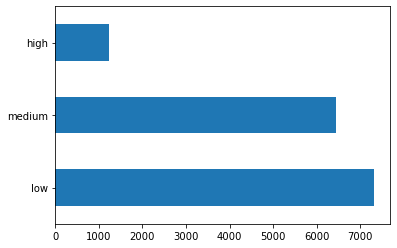

In [75]:
df['salary'].value_counts().plot.barh()

In [121]:
df.groupby(['department', 'salary']).size()

department   salary
IT           high        83
             low        609
             medium     535
RandD        high        51
             low        364
             medium     372
accounting   high        74
             low        358
             medium     335
hr           high        45
             low        335
             medium     359
management   high       225
             low        180
             medium     225
marketing    high        80
             low        402
             medium     376
product_mng  high        68
             low        451
             medium     383
sales        high       269
             low       2099
             medium    1772
support      high       141
             low       1146
             medium     942
technical    high       201
             low       1372
             medium    1147
dtype: int64

# 6. Показать распределение сотрудников по зарплатам в каждом департаменте по отдельности

In [135]:
salary_by_department = df[['department','salary']].pivot_table(index='department', columns='salary', aggfunc=len)
salary_by_department

salary,high,low,medium
department,,,
IT,83,609,535
RandD,51,364,372
accounting,74,358,335
hr,45,335,359
management,225,180,225
marketing,80,402,376
product_mng,68,451,383
sales,269,2099,1772
support,141,1146,942


<AxesSubplot:xlabel='department'>

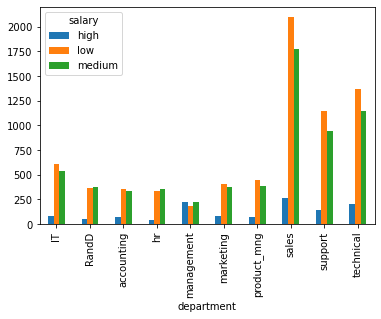

In [137]:
salary_by_department.plot.bar()

<AxesSubplot:xlabel='department,salary'>

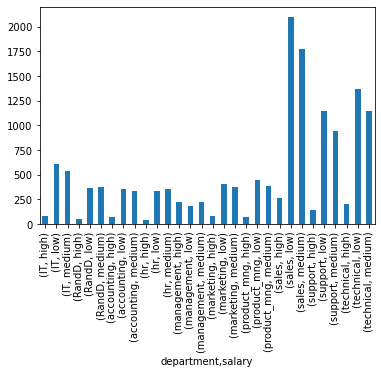

In [136]:
# ещё один вариант визуализации зарплат по отделам без использования сводной таблицы
df.groupby(['department', 'salary']).size().plot.bar()

# 7. Проверить гипотезу, что сотрудники с высоким окладом проводят на работе больше времени, чем сотрудники с низким окладом


<AxesSubplot:title={'center':'Correlation between salary and User average montly hours'}, xlabel='average_montly_hours', ylabel='salary'>

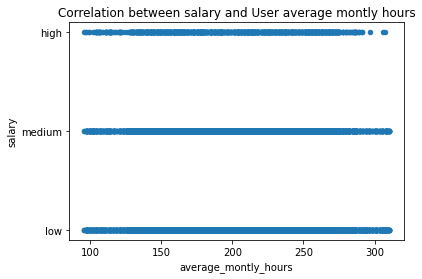

In [148]:
df.plot(kind='scatter', 
        x='average_montly_hours', 
        y='salary', 
        title='Correlation between salary and User average montly hours')
# Вывод: Из визуализации видно, уровень зп не влияет на кол-во рабочих часов, но сотрудники с высоким уровнем зп реже проводят больше времени на работе чем сотрудники с низкой и средней зп, соответственно гипотеза не подтверждается.

# 8. Рассчитать следующие показатели среди уволившихся и не уволившихся сотрудников (по отдельности):
<li>Доля сотрудников с повышением за последние 5 лет</li>
<li>Средняя степень удовлетворенности</li>
<li>Среднее количество проектов</li>


In [158]:
left_df = df.loc[df['left'] == 1]
not_left_df = df.loc[df['left'] == 0]

In [173]:
# Доля сотрудников с повышением за последние 5 лет:
promotion_for_left = (left_df['promotion_last_5years'].value_counts(normalize=True) * 100)[1]
promotion_for_not_left = (not_left_df['promotion_last_5years'].value_counts(normalize=True) * 100)[1]

print(f'Доля уволившихся сотрудников с повышением за последние 5 лет: {promotion_for_left:.2f}%')
print(f'Доля не уволившихся сотрудников с повышением за последние 5 лет: {promotion_for_not_left:.2f}%')

Доля уволившихся сотрудников с повышением за последние 5 лет: 0.53%
Доля не уволившихся сотрудников с повышением за последние 5 лет: 2.63%


In [177]:
# Средняя степень удовлетворенности
satisfaction_for_left = left_df['satisfaction_level'].mean()
satisfaction_for_not_left = not_left_df['satisfaction_level'].mean()

print(f'Средняя степень удовлетворенности для уволившихся сотрудников: {satisfaction_for_left:.2f}')
print(f'Средняя степень удовлетворенности для не уволившихся сотрудников: {satisfaction_for_not_left:.2f}')

Средняя степень удовлетворенности для уволившихся сотрудников: 0.44%
Средняя степень удовлетворенности для не уволившихся сотрудников: 0.67%


In [179]:
# Среднее количество проектов
mean_projects_count_for_left = left_df['number_project'].mean()
mean_projects_count_for_not_left = not_left_df['number_project'].mean()

print(f'Среднее количество проектов для уволившихся сотрудников: {mean_projects_count_for_left:.0f}')
print(f'Среднее количество проектов для не уволившихся сотрудников: {mean_projects_count_for_not_left:.0f}')

Среднее количество проектов для уволившихся сотрудников: 4
Среднее количество проектов для не уволившихся сотрудников: 4


# 9. Linear Discriminant Analysis
<li>Разделить данные на тестовую и обучающую выборки</li>
<li>Построить модель LDA, предсказывающую уволился ли
сотрудник на основе имеющихся факторов (кроме department и
salary)</li>
<li>Оценить качество модели на тестовой выборки</li>


In [259]:
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split

In [260]:
cols = ['satisfaction_level', 'last_evaluation', 'number_project', 'average_montly_hours', 'time_spend_company', 'Work_accident', 'promotion_last_5years']
X = df[cols]
y = df['left']

In [261]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.30, random_state=42)

In [262]:
X_train.shape

(10499, 7)

In [263]:
y_train.shape

(10499,)

In [264]:
# обучение на данных и подбор оптимальных коэффициентов
model = LinearRegression()
model.fit(X_train, y_train)  

LinearRegression()

In [265]:
# коэффициент уравнения (a)
model.coef_

array([-6.67146494e-01,  8.94636378e-02, -3.06965508e-02,  6.63799684e-04,
        3.22562759e-02, -1.53085014e-01, -1.58223059e-01])

In [266]:
# независимый член уравнения (b)
model.intercept_

0.479535955306176

In [267]:
y_pred = model.predict(X_test)
y_pred

array([ 0.03973934,  0.0466316 ,  0.22135527, ...,  0.11480934,
       -0.02000725,  0.07926176])

In [269]:
# значение коэффициента детерминации
model.score(X_test, y_test) 

# Вывод: очень низкое качество модели

0.18326882703830805

In [272]:
X_test['y_pred'] = y_pred
X_test['y_test'] = y_test
X_test

<ipython-input-272-4baab8c00b4e>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X_test['y_pred'] = y_pred
<ipython-input-272-4baab8c00b4e>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X_test['y_test'] = y_test


,satisfaction_level,last_evaluation,number_project,average_montly_hours,time_spend_company,Work_accident,promotion_last_5years,y_pred,y_test
6723,0.65,0.96,5,226,2,1,0,0.039739,0
6473,0.88,0.80,3,166,2,0,0,0.046632,0
4679,0.69,0.98,3,214,2,0,0,0.221355,0
862,0.41,0.47,2,154,3,0,0,0.385655,1
7286,0.87,0.76,5,254,2,1,0,-0.106339,0
...,...,...,...,...,...,...,...,...,...
13388,0.85,0.81,4,260,3,0,0,0.131498,0
10463,0.21,0.43,2,249,3,0,0,0.578566,0
5331,0.78,0.53,3,156,3,0,0,0.114809,0
7499,0.93,0.58,5,238,2,0,0,-0.020007,0


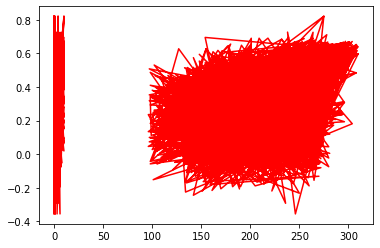

In [274]:
plt.plot(X_test, y_pred, c='r')